In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

In [2]:
df_as=pd.read_csv('Asthma_total_data2.csv',sep=';')
df_as=df_as.iloc[1:,1:]
for el in df_as.iloc[:,1:]:
    df_as[el]=df_as[el].astype('float')
df_as.head()

,Unnamed: 1,2005,Unnamed: 3,Unnamed: 4,2006,Unnamed: 6,Unnamed: 7,2007,Unnamed: 9,Unnamed: 10,...,Unnamed: 28,2014,Unnamed: 30,Unnamed: 31,2015,Unnamed: 33,Unnamed: 34,2016,Unnamed: 36,Unnamed: 37
1,New York City,5027.0,4656.0,9683.0,5164.0,4525.0,9689.0,4665.0,4194.0,8859.0,...,7738.0,3922.0,4106.0,8028.0,3514.0,3547.0,7061.0,3380.0,3373.0,6753.0
2,Bronx,1791.0,1594.0,3385.0,1766.0,1542.0,3308.0,1691.0,1476.0,3167.0,...,3166.0,1569.0,1691.0,3260.0,1407.0,1489.0,2896.0,1317.0,1340.0,2657.0
3,Brooklyn,1481.0,1414.0,2895.0,158.0,1424.0,3004.0,1309.0,1200.0,2509.0,...,2233.0,1147.0,1155.0,2302.0,1023.0,994.0,2017.0,977.0,990.0,1967.0
4,Manhattan,597.0,698.0,1295.0,654.0,605.0,1259.0,526.0,598.0,1124.0,...,901.0,460.0,482.0,942.0,400.0,421.0,821.0,416.0,440.0,856.0
5,Queens,1026.0,831.0,1857.0,1048.0,823.0,1871.0,1033.0,814.0,1847.0,...,1239.0,654.0,663.0,1317.0,602.0,540.0,1142.0,559.0,506.0,1650.0


In [3]:
names=['Area']
categories=['0 to 4 years','5 to 17 Years','0 to 17 Years']
for i in range(2005,2017):
    for j in range(1,4):
        names.append(str(i)+'-'+str(j))
df_as.columns=names
df_as[0:6]

,Area,2005-1,2005-2,2005-3,2006-1,2006-2,2006-3,2007-1,2007-2,2007-3,...,2013-3,2014-1,2014-2,2014-3,2015-1,2015-2,2015-3,2016-1,2016-2,2016-3
1,New York City,5027.0,4656.0,9683.0,5164.0,4525.0,9689.0,4665.0,4194.0,8859.0,...,7738.0,3922.0,4106.0,8028.0,3514.0,3547.0,7061.0,3380.0,3373.0,6753.0
2,Bronx,1791.0,1594.0,3385.0,1766.0,1542.0,3308.0,1691.0,1476.0,3167.0,...,3166.0,1569.0,1691.0,3260.0,1407.0,1489.0,2896.0,1317.0,1340.0,2657.0
3,Brooklyn,1481.0,1414.0,2895.0,158.0,1424.0,3004.0,1309.0,1200.0,2509.0,...,2233.0,1147.0,1155.0,2302.0,1023.0,994.0,2017.0,977.0,990.0,1967.0
4,Manhattan,597.0,698.0,1295.0,654.0,605.0,1259.0,526.0,598.0,1124.0,...,901.0,460.0,482.0,942.0,400.0,421.0,821.0,416.0,440.0,856.0
5,Queens,1026.0,831.0,1857.0,1048.0,823.0,1871.0,1033.0,814.0,1847.0,...,1239.0,654.0,663.0,1317.0,602.0,540.0,1142.0,559.0,506.0,1650.0
6,Staten Island,132.0,119.0,251.0,116.0,131.0,247.0,106.0,106.0,212.0,...,199.0,92.0,115.0,207.0,82.0,103.0,185.0,111.0,97.0,208.0


In [4]:
def vector_per_year(Area_Name):
    # get index of Total per year
    n=list(range(0,12))
    idx_total=[el*3+3 for el in n]
    return [df_as[df_as.Area==Area_Name].values[0][i] for i in idx_total]

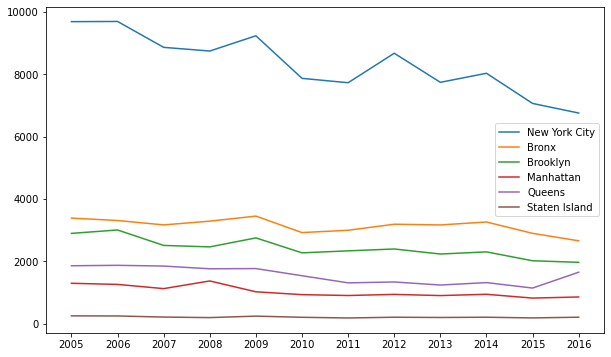

In [5]:
# Total number of Asthma hospitalizations per year
plt.figure(figsize=(10,6))
for el in df_as.Area[0:6]:
    plt.plot(vector_per_year(el),label=el)
plt.xticks(list(range(0,12)),list(range(2005,2017)))
plt.legend()
plt.show()

It's hard to observe the evolution and changes per year, let's do it proportional to the total average per years.

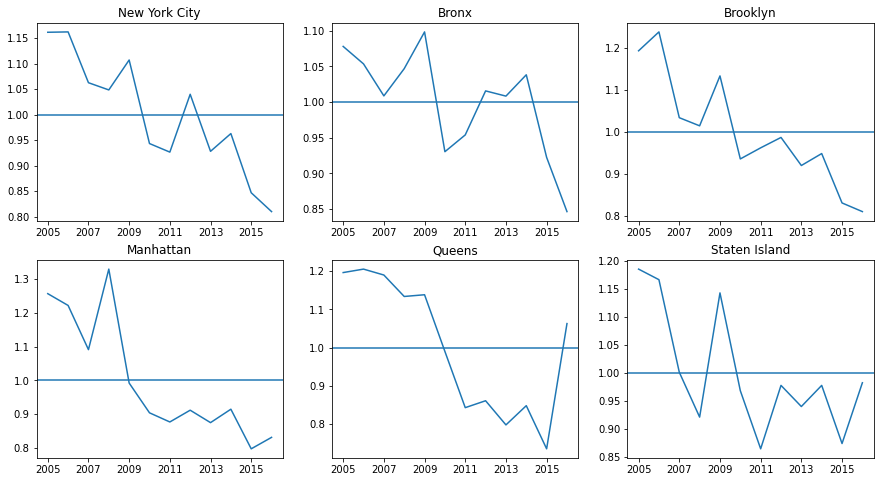

In [6]:
# Total number of Asthma hospitalizations per year
plt.figure(figsize=(15,8))
i=1
for el in df_as.Area[0:6]:
    plt.subplot(2,3,i)
    plt.plot(vector_per_year(el)/np.mean(vector_per_year(el)),label=el)
    plt.axline((0,1),(11,1))
    i+=1;plt.title(el)
    plt.xticks(list(range(0,12,2)),list(range(2005,2017,2)))
#plt.legend()
plt.show()

In [30]:
np.random.rand(10)

array([0.0430919 , 0.18986648, 0.20519794, 0.09665218, 0.06350699,
       0.27248179, 0.11519314, 0.11408206, 0.19379908, 0.2409497 ])

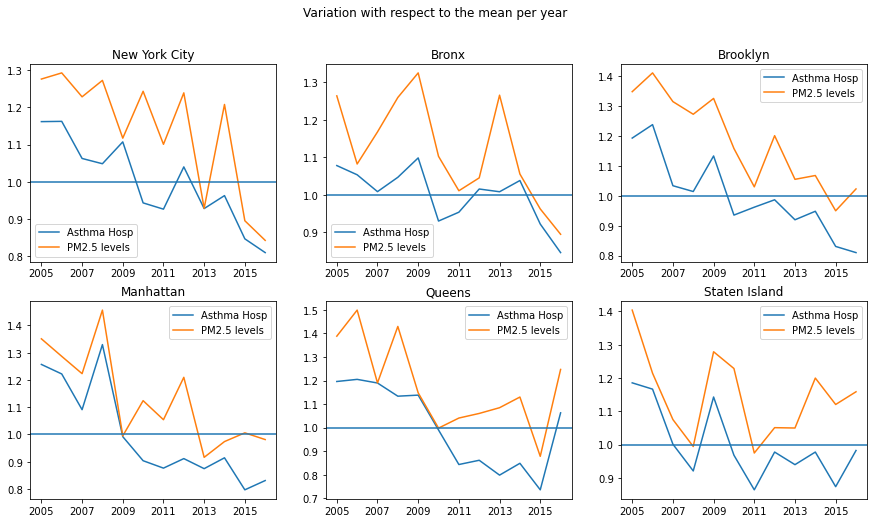

In [39]:
# Total number of Asthma hospitalizations per year
plt.figure(figsize=(15,8))
i=1
for el in df_as.Area[0:6]:
    plt.subplot(2,3,i)
    plt.plot(vector_per_year(el)/np.mean(vector_per_year(el)),label='Asthma Hosp')
    noise_vec=vector_per_year(el)/np.mean(vector_per_year(el))+np.random.rand(12)*0.3
    plt.plot(noise_vec,label='PM2.5 levels')
    plt.axline((0,1),(11,1))
    i+=1;plt.title(el)
    plt.xticks(list(range(0,12,2)),list(range(2005,2017,2)))
    plt.legend()
plt.suptitle('Variation with respect to the mean per year')
plt.show()

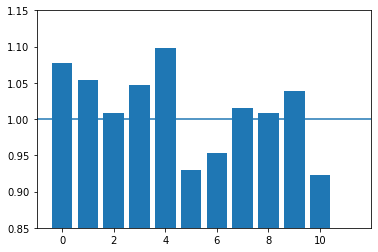

In [7]:
plt.bar(list(range(0,12)),vector_per_year('Bronx')/np.mean(vector_per_year('Bronx')),label=el)
plt.axline((0,1),(11,1))
plt.ylim([0.85,1.15]);plt.show()

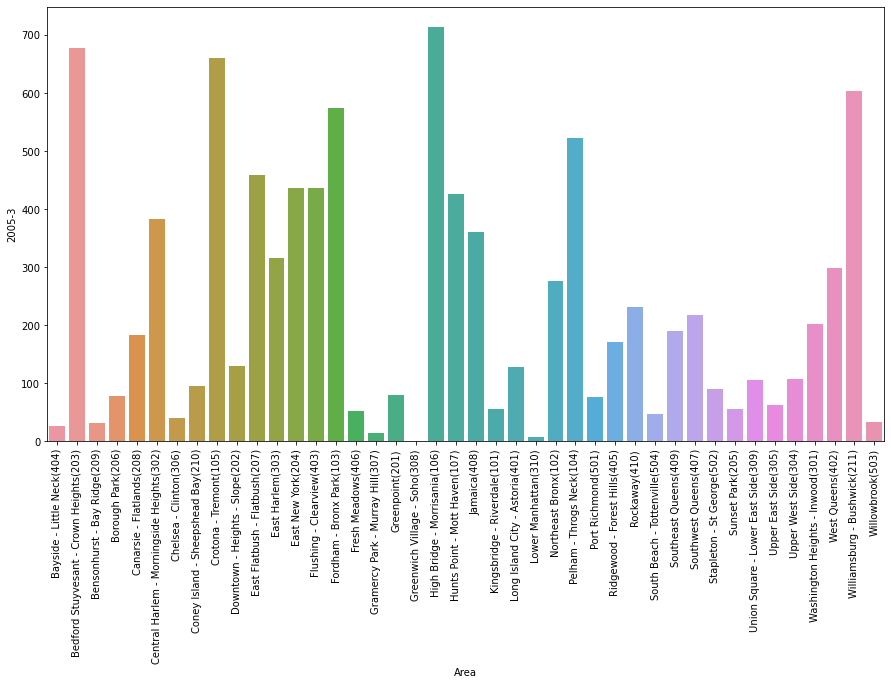

In [8]:
plt.figure(figsize=(15,8))
ax = sns.barplot(x="Area", y="2005-3", data=df_as[6:])
plt.xticks(rotation=90);plt.show()

In [10]:
df2=pd.read_csv('Air_Quality.csv')
df2[df2.Name=='Fine Particulate Matter (PM2.5)']

,Unique ID,Indicator ID,Name,Measure,Measure Info,Geo Type Name,Geo Join ID,Geo Place Name,Time Period,Start_Date,Data Value,Message
0,333939,365,Fine Particulate Matter (PM2.5),Mean,mcg per cubic meter,Borough,1,Bronx,Winter 2014-15,12/01/2014,10.21,NaN
1,547354,365,Fine Particulate Matter (PM2.5),Mean,mcg per cubic meter,Borough,1,Bronx,Annual Average 2017,01/01/2017,7.72,NaN
2,605650,365,Fine Particulate Matter (PM2.5),Mean,mcg per cubic meter,Borough,1,Bronx,Winter 2017-18,12/01/2017,8.28,NaN
3,179503,365,Fine Particulate Matter (PM2.5),Mean,mcg per cubic meter,Borough,1,Bronx,Winter 2010-11,12/01/2010,13.85,NaN
4,179643,365,Fine Particulate Matter (PM2.5),Mean,mcg per cubic meter,Borough,1,Bronx,Annual Average 2009,12/01/2008,11.05,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...
4247,605648,365,Fine Particulate Matter (PM2.5),Mean,mcg per cubic meter,Borough,1,Bronx,Annual Average 2018,01/01/2018,7.25,NaN
4248,179573,365,Fine Particulate Matter (PM2.5),Mean,mcg per cubic meter,Borough,1,Bronx,Summer 2010,06/01/2010,12.12,NaN
4249,179578,365,Fine Particulate Matter (PM2.5),Mean,mcg per cubic meter,Borough,1,Bronx,Summer 2011,06/01/2011,11.66,NaN
4250,179588,365,Fine Particulate Matter (PM2.5),Mean,mcg per cubic meter,Borough,1,Bronx,Summer 2013,06/01/2013,10.44,NaN


In [20]:
np.unique(df2['Time Period'])

array(['2-Year Summer Average 2009-2010', '2005', '2005-2007',
       '2009-2011', '2011', '2012-2014', '2013', '2015', '2015-2017',
       '2016', 'Annual Average 2009', 'Annual Average 2010',
       'Annual Average 2011', 'Annual Average 2012',
       'Annual Average 2013', 'Annual Average 2014',
       'Annual Average 2015', 'Annual Average 2016',
       'Annual Average 2017', 'Annual Average 2018', 'Summer 2009',
       'Summer 2010', 'Summer 2011', 'Summer 2012', 'Summer 2013',
       'Summer 2014', 'Summer 2015', 'Summer 2016', 'Summer 2017',
       'Summer 2018', 'Winter 2008-09', 'Winter 2009-10',
       'Winter 2010-11', 'Winter 2011-12', 'Winter 2012-13',
       'Winter 2013-14', 'Winter 2014-15', 'Winter 2015-16',
       'Winter 2016-17', 'Winter 2017-18'], dtype=object)

In [11]:
np.unique(df2['Geo Place Name'])

array(['Bay Ridge and Dyker Heights (CD10)', 'Bayside - Little Neck',
       'Bayside Little Neck-Fresh Meadows',
       'Bayside and Little Neck (CD11)', 'Bedford Stuyvesant (CD3)',
       'Bedford Stuyvesant - Crown Heights',
       'Belmont and East Tremont (CD6)', 'Bensonhurst (CD11)',
       'Bensonhurst - Bay Ridge', 'Borough Park', 'Borough Park (CD12)',
       'Bronx', 'Brooklyn', 'Brownsville (CD16)', 'Bushwick (CD4)',
       'Canarsie - Flatlands', 'Central Harlem (CD10)',
       'Central Harlem - Morningside Heights', 'Chelsea - Clinton',
       'Chelsea-Village', 'Clinton and Chelsea (CD4)',
       'Coney Island (CD13)', 'Coney Island - Sheepshead Bay',
       'Crotona -Tremont', 'Crown Heights and Prospect Heights (CD8)',
       'Downtown - Heights - Slope', 'East Flatbush (CD17)',
       'East Flatbush - Flatbush', 'East Harlem', 'East Harlem (CD11)',
       'East New York', 'East New York and Starrett City (CD5)',
       'Elmhurst and Corona (CD4)', 'Financial District (

In [15]:
df4=pd.read_csv('New_York_City_Population_By_Neighborhood_Tabulation_Areas.csv')
df4

,Borough,Year,FIPS County Code,NTA Code,NTA Name,Population
0,Bronx,2000,5,BX01,Claremont-Bathgate,28149
1,Bronx,2000,5,BX03,Eastchester-Edenwald-Baychester,35422
2,Bronx,2000,5,BX05,Bedford Park-Fordham North,55329
3,Bronx,2000,5,BX06,Belmont,25967
4,Bronx,2000,5,BX07,Bronxdale,34309
...,...,...,...,...,...,...
385,Staten Island,2010,85,SI37,Stapleton-Rosebank,26453
386,Staten Island,2010,85,SI45,New Dorp-Midland Beach,21896
387,Staten Island,2010,85,SI48,Arden Heights,25238
388,Staten Island,2010,85,SI54,Great Kills,40720


In [16]:
import pandas as pd
import json
import math
import plotly.express as px
from area import area

# read the neighborhood population data into a DataFrame and load the GeoJSON data
df = pd.read_csv('New_York_City_Population_By_Neighborhood_Tabulation_Areas.csv')
nycmap = json.load(open("nyc_neighborhoods.geojson"))

# create dictionary of nta codes mapping to area (square miles)
d = {}
neighborhood = nycmap["features"]
for n in neighborhood:
    code = n["properties"]["ntacode"]
    a = area(n["geometry"])/(1609*1609) # converts from m^2 to mi^2
    d[code] = a

# create new columns in df for area and density  
df["area"] = df["NTA Code"].map(d)
df = df.dropna(subset=["area"])
df["density"] = df["Population"]/df["area"]

# call Plotly Express choropleth function to visualize data
fig = px.choropleth_mapbox(df,
                           geojson=nycmap,
                           locations="NTA Code",
                           featureidkey="properties.ntacode",
                           color="density",
                           color_continuous_scale="viridis",
                           mapbox_style="carto-positron",
                           zoom=9, center={"lat": 40.7, "lon": -73.9},
                           opacity=0.7,
                           hover_name="NTA Name"
                           )

fig.show()

In [17]:
import pandas as pd
import json
import math
import plotly.express as px
import numpy as np
from sklearn import neighbors

# load geojson data for manhattan
nycmap = json.load(open("nycpluto_manhattan.geojson"))

# load library data from csv file, convert coordinates to radians, and create coordinate pairs
libs = pd.read_csv('manhattanlibraries.csv', usecols=['facname', 'latitude', 'longitude'])
libs['latitude'] = libs['latitude'].apply(func=math.radians)
libs['longitude'] = libs['longitude'].apply(func=math.radians)
libs['coord'] = list(zip(libs['latitude'], libs['longitude']))

# load library data into BallTree
libcoords = np.asarray(list(libs['coord']))
tree = neighbors.BallTree(libcoords, metric="haversine")

# load lot data from csv file, convert coordinates to radians, and create coordinate pairs
df = pd.read_csv('pluto_small.csv')
df = df.dropna(subset=['assesstot', 'bldgarea', 'lotarea', 'latitude', 'longitude'])
df['latitude'] = df['latitude'].apply(func=math.radians)
df['longitude'] = df['longitude'].apply(func=math.radians)
df['coord'] = list(zip(df['latitude'], df['longitude']))

# query the BallTree and save results back in df
lotcoords = np.asarray(list(df['coord']))
dist, _ = tree.query(X=lotcoords, k=1)
df['dist'] = dist
df['dist'] = df['dist'].apply(lambda x: x*3960)

# use Plotly express function to create a choropleth map
fig = px.choropleth_mapbox(df,
                           geojson=nycmap,
                           locations="bbl",
                           featureidkey="properties.bbl",
                           color="dist",
                           color_continuous_scale=px.colors.sequential.thermal[::-1],
                           range_color=(0, 0.5),
                           mapbox_style="carto-positron",
                           zoom=9, center={"lat": 40.7, "lon": -73.7},
                           opacity=0.7,
                           hover_name="ownername"
                           )

fig.show()

FileNotFoundError: [Errno 2] No such file or directory: 'nycpluto_manhattan.geojson'